# Analysis of pre-processed datasets

In [1]:
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning) #Suppress Future Warnings

import pandas as pd
import numpy as np
import scanpy as sc
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import diffxpy.api as de
import math
from adjustText import adjust_text

sc.settings.verbosity = 0 # verbosity: errors (0), warnings (1), info (2), hints (3)
pd.options.mode.chained_assignment = None #Suppress setting with copy warning

## Define custom functions

In [2]:
def convert_significance(p):
    sig=', n.s.'
    if p < 0.05:
        sig='*'
    if p < 0.01:
        sig='**'
    if p < 0.001:
        sig='***'
    if p < 0.0001:
        sig='***'
    return sig

def make_volcano_diffxpy(adata, groupby='batch', is_logged=True, min_pval=20, min_lfc=0.5, return_genes=False, 
                         log10_p_threshold=1000, ax='none'):
    
    test = de.test.t_test(
    data=adata,
    grouping=groupby,
    is_logged=is_logged)
    tab = test.summary()
    tab['-log10(corrected pvalue)']=[-math.log10(x) if x!=0 else -math.log10(tab[tab.qval>0].qval.min()) for x in tab.qval]
    clipped=False
    if (tab['-log10(corrected pvalue)']>log10_p_threshold).sum()>0:
        tab['-log10(corrected pvalue)'][tab['-log10(corrected pvalue)']>log10_p_threshold]=log10_p_threshold
        clipped=True
    tab['color']='under_th'
    tab['color'][np.logical_and(tab['-log10(corrected pvalue)']>min_pval,tab.log2fc>min_lfc)]='selected'+str(np.unique(test.grouping)[1])
    tab['color'][np.logical_and(tab['-log10(corrected pvalue)']>min_pval,tab.log2fc<-min_lfc)]='selected'+str(np.unique(test.grouping)[0])
    sns.scatterplot(x=tab.log2fc, y=tab['-log10(corrected pvalue)'], hue=tab.color, palette=['blue','red','gray'], 
                       hue_order=['selected'+str(np.unique(test.grouping)[0]),
                                  'selected'+str(np.unique(test.grouping)[1]),'under_th'], 
                       edgecolor='black', linewidth=.3, legend=False, ax=ax)
    text_values=[]
    for line in range(0,tab.shape[0]):
        if tab.iloc[line].color=='selected'+str(np.unique(test.grouping)[0]):
            text_values+=[ax.text(tab.log2fc[line]+0.05, tab['-log10(corrected pvalue)'][line], tab.gene[line],
                    horizontalalignment='left', size=6, color='black')]
        if tab.iloc[line].color=='selected'+str(np.unique(test.grouping)[1]):
            text_values+=[ax.text(tab.log2fc[line]-0.05, tab['-log10(corrected pvalue)'][line], tab.gene[line], 
                    horizontalalignment='right', size=6, color='black')]
    adjust_text(text_values, arrowprops=dict(arrowstyle='-', color='gray'), alpha=.5)
    ax.set_title('diff. genes '+groupby+' '+str(np.unique(test.grouping)[1])+' vs '+str(np.unique(test.grouping)[0]))
    ax.grid(False)
    if clipped==True:
        labels=ax.get_yticklabels()
        ax.set_yticks(ax.get_yticks().tolist()+[log10_p_threshold])
        ax.set_yticklabels(labels+['>'+str(log10_p_threshold)])
    xabs_max = abs(max(ax.get_xlim(), key=abs))
    ax.set_xlim(xmin=-xabs_max, xmax=xabs_max)
    plt.vlines(x=[min_lfc, -min_lfc], ymin=ax.get_ylim()[0], ymax=ax.get_ylim()[1], linestyles='--', alpha=.5)
    plt.vlines(x=0, ymin=ax.get_ylim()[0], ymax=ax.get_ylim()[1], alpha=.5)
    plt.hlines(y=min_pval, xmin=ax.get_xlim()[0], xmax=ax.get_xlim()[1], linestyles='--', alpha=.5)
    plt.savefig('./figures/volcano_'+groupby+'_'+str(np.unique(test.grouping)[1])+'_vs_'+str(np.unique(test.grouping)[0])+'.svg')
    if return_genes==True:
        return tab
    
sc.settings.set_figure_params(dpi=80, dpi_save=400, color_map='viridis')

## Read data

In [3]:
adata=sc.read('./write/COVID_I.h5ad')
adata_II=sc.read('F:/10x_data_COVID_II/COVID_II.h5ad')

In [4]:
sequences=[0]*2
sequences[0]=pd.read_json('./GEX_1/VDJ/all_contig_annotations.json')
sequences[1]=pd.read_json('./GEX_2/VDJ/all_contig_annotations.json')
sequences_II=[0]*2
sequences_II[0]=pd.read_json('F:/10x_data_COVID_II/VDJ_1/outs/all_contig_annotations.json')
sequences_II[1]=pd.read_json('F:/10x_data_COVID_II/VDJ_2/outs/all_contig_annotations.json')
columns=['TRA_1_cdr3', 'TRA_2_cdr3', 'TRB_1_cdr3', 'TRB_2_cdr3', 'TRA_1_expr', 'TRA_2_expr', 'TRB_1_expr', 'TRB_2_expr', 'TRA_1_v_gene', 'TRA_2_v_gene', 'TRB_1_v_gene', 'TRB_2_v_gene', 'TRA_1_j_gene', 'TRA_2_j_gene', 'TRB_1_j_gene', 'TRB_2_j_gene', 'TRA_1_c_gene', 'TRA_2_c_gene', 'TRB_1_c_gene', 'TRB_2_c_gene', 'TRA_1_cdr3_nt', 'TRA_2_cdr3_nt', 'TRB_1_cdr3_nt', 'TRB_2_cdr3_nt', 'chain_pairing', 'clonotype', 'clonotype_size','IFNG']

In [5]:
adata.obs['IFNG_']=[x[0] for x in adata[:,adata.var_names=='IFNG'].X]
adata_II.obs['IFNG_']=[x[0] for x in adata_II.raw[:,adata_II.raw.var_names=='IFNG'].X.todense().tolist()]

In [6]:
single_donor_adatas_II=[0]*len(adata_II.obs.samplename.unique())
single_donor_adatas_names_II=[0]*len(adata_II.obs.samplename.unique())
for i in range(len(adata_II.obs.samplename.unique())):
    single_donor_adatas_II[i]=adata_II[adata_II.obs['samplename']==adata_II.obs.samplename.unique()[i],:]
    single_donor_adatas_names_II[i]=adata_II.obs.samplename.unique()[i]

In [7]:
single_donor_adatas=[0]*len(['Donor 34','Donor 24','Donor 33','Donor 32'])
single_donor_adatas_names=['Donor 34','Donor 24','Donor 33','Donor 32']
for i, name in enumerate(single_donor_adatas_names):
    single_donor_adatas[i]=adata[adata.obs['donor']==name]

## Write TCR information to tables

In [8]:
for j, adata_s in enumerate(single_donor_adatas):
    clones=adata_s.obs.clonotype[adata_s.obs.has_tcr=='True'].value_counts().sort_values(ascending=False).index.tolist()
    #adata_s.obs[(adata_s.obs.clonotype.isin(clones))&(adata_s.obs.has_tcr=='True')][columns].sort_values('clonotype_size', ascending=False).to_excel('./single_cell_TCR_sequences_'+single_donor_adatas_names[j]+'.xls')
    df_temp=adata_s[(adata_s.obs.clonotype.isin(clones))&(adata_s.obs.has_tcr=='True')].obs.groupby('clonotype').agg({'clonotype_size':'mean', 'IFNG_':'mean',
                                                                                      'batch':lambda x:x.value_counts().index[0],
                                                                                      'donor':lambda x:x.value_counts().index[0],
                                                                                      'leiden':lambda x:x.value_counts().index[0],
                                                                                      'TRA_1_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_1_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_1_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRA_1_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'chain_pairing':lambda x:x.value_counts().index[0]})
    df_temp['size_sample']=adata_s[(adata_s.obs.clonotype.isin(clones))&(adata_s.obs.has_tcr=='True')].obs.groupby('clonotype').agg({'clonotype_size':'count'})['clonotype_size'].tolist()
    df_temp['alpha_1_contig']='none'
    df_temp['beta_1_contig']='none'
    df_temp['alpha_2_contig']='none'
    df_temp['beta_2_contig']='none'
    for i in range(df_temp.shape[0]):
        if df_temp.iloc[i].TRA_1_cdr3 != 'None':
            df_temp.alpha_1_contig[i]=sequences[int(df_temp.iloc[i].batch)][sequences[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRA_1_cdr3].sequence.value_counts().index[0]
        if df_temp.iloc[i].TRB_1_cdr3 != 'None':
            df_temp.beta_1_contig[i]=sequences[int(df_temp.iloc[i].batch)][sequences[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRB_1_cdr3].sequence.value_counts().index[0]
        if df_temp.iloc[i].TRA_2_cdr3 != 'None':
            df_temp.alpha_2_contig[i]=sequences[int(df_temp.iloc[i].batch)][sequences[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRA_2_cdr3].sequence.value_counts().index[0]
        if df_temp.iloc[i].TRB_2_cdr3 != 'None':
            df_temp.beta_2_contig[i]=sequences[int(df_temp.iloc[i].batch)][sequences[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRB_2_cdr3].sequence.value_counts().index[0]
    df_temp[['clonotype_size', 'size_sample', 'donor', 'IFNG_', 'leiden', 'TRA_1_v_gene',
       'TRA_1_j_gene', 'TRA_1_cdr3', 'TRA_1_cdr3_nt', 'TRB_1_v_gene',
       'TRB_1_j_gene', 'TRB_1_cdr3', 'TRB_1_cdr3_nt', 'TRA_2_v_gene',
       'TRA_2_j_gene', 'TRA_2_cdr3', 'TRA_2_cdr3_nt', 'TRB_2_v_gene',
       'TRB_2_j_gene', 'TRB_2_cdr3', 'TRB_2_cdr3_nt',
       'alpha_1_contig', 'beta_1_contig', 'alpha_2_contig', 'beta_2_contig', 'chain_pairing']].sort_values('size_sample', ascending=False).to_excel('./TCR_sequences_condensed_'+single_donor_adatas_names[j]+'.xls')

In [9]:
for j, adata_s in enumerate(single_donor_adatas_II):
    clones=adata_s.obs.clonotype[adata_s.obs.has_tcr=='True'].value_counts().sort_values(ascending=False).index.tolist()
    #adata_s.obs[(adata_s.obs.clonotype.isin(clones))&(adata_s.obs.has_tcr=='True')][columns].sort_values('clonotype_size', ascending=False).to_excel('./single_cell_TCR_sequences_'+single_donor_adatas_names_II[j]+'.xls')
    df_temp=adata_s[(adata_s.obs.clonotype.isin(clones))&(adata_s.obs.has_tcr=='True')].obs.groupby('clonotype').agg({'clonotype_size':'mean', 'IFNG_':'mean',
                                                                                      'batch':lambda x:x.value_counts().index[0],
                                                                                      'samplename':lambda x:x.value_counts().index[0],
                                                                                      'leiden':lambda x:x.value_counts().index[0],
                                                                                      'TRA_1_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_1_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_1_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRA_1_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRB_1_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRA_2_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_v_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_j_gene':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_cdr3':lambda x:x.value_counts().index[0],
                                                                                     'TRB_2_cdr3_nt':lambda x:x.value_counts().index[0],
                                                                                     'chain_pairing':lambda x:x.value_counts().index[0]})
    df_temp['size_sample']=adata_s[(adata_s.obs.clonotype.isin(clones))&(adata_s.obs.has_tcr=='True')].obs.groupby('clonotype').agg({'clonotype_size':'count'})['clonotype_size'].tolist()
    df_temp['alpha_1_contig']='none'
    df_temp['beta_1_contig']='none'
    df_temp['alpha_2_contig']='none'
    df_temp['beta_2_contig']='none'
    for i in range(df_temp.shape[0]):
        if df_temp.iloc[i].TRA_1_cdr3 != 'None':
            df_temp.alpha_1_contig[i]=sequences_II[int(df_temp.iloc[i].batch)][sequences_II[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRA_1_cdr3].sequence.value_counts().index[0]
        if df_temp.iloc[i].TRB_1_cdr3 != 'None':
            df_temp.beta_1_contig[i]=sequences_II[int(df_temp.iloc[i].batch)][sequences_II[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRB_1_cdr3].sequence.value_counts().index[0]
        if df_temp.iloc[i].TRA_2_cdr3 != 'None':
            df_temp.alpha_2_contig[i]=sequences_II[int(df_temp.iloc[i].batch)][sequences_II[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRA_2_cdr3].sequence.value_counts().index[0]
        if df_temp.iloc[i].TRB_2_cdr3 != 'None':
            df_temp.beta_2_contig[i]=sequences_II[int(df_temp.iloc[i].batch)][sequences_II[int(df_temp.iloc[i].batch)].cdr3==df_temp.iloc[i].TRB_2_cdr3].sequence.value_counts().index[0]
    df_temp[['clonotype_size', 'size_sample', 'samplename', 'IFNG_', 'leiden', 'TRA_1_v_gene',
       'TRA_1_j_gene', 'TRA_1_cdr3', 'TRA_1_cdr3_nt', 'TRB_1_v_gene',
       'TRB_1_j_gene', 'TRB_1_cdr3', 'TRB_1_cdr3_nt', 'TRA_2_v_gene',
       'TRA_2_j_gene', 'TRA_2_cdr3', 'TRA_2_cdr3_nt', 'TRB_2_v_gene',
       'TRB_2_j_gene', 'TRB_2_cdr3', 'TRB_2_cdr3_nt',
       'alpha_1_contig', 'beta_1_contig', 'alpha_2_contig', 'beta_2_contig', 'chain_pairing']].sort_values('size_sample', ascending=False).to_excel('./TCR_sequences_condensed_'+single_donor_adatas_names_II[j]+'.xls')

## Generate Figures

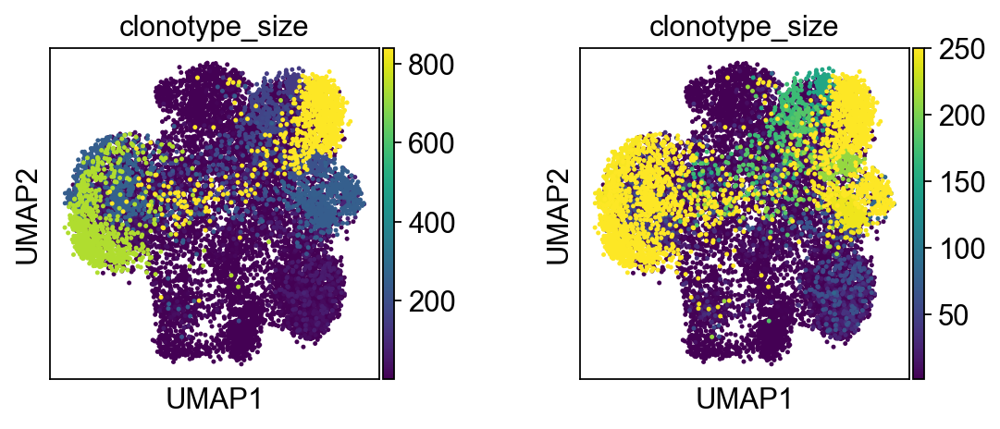

In [10]:
fig, ax=plt.subplots(ncols=2, figsize=(7,3))
fig.tight_layout(w_pad=3)
sc.pl.umap(adata, color='clonotype_size', s=20, ax=ax[0], show=False)
sc.pl.umap(adata, color='clonotype_size', s=20, vmax=250, ax=ax[1], show=False)
fig.savefig('./figures_paper/clonotype_size.svg', bbox_inches='tight')

In [11]:
EC50 = pd.read_csv('EC50.csv', sep=";", decimal =",", index_col="TCR")
EC50=EC50.fillna(0)
interesting_clonotypes=["13","18","28","32","40","43","82","3398","3399","3409","3456"]

In [12]:
sc.settings.verbosity=0
mean = adata.obs[adata.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').mean().iloc[interesting_clonotypes]
mean["EC50"]=EC50.EC50.tolist()
mean["Offrate"]=EC50.Offrate.tolist()
IFNG=[]
IFNG_percent=[]
GZMA=[]
for clonotype in interesting_clonotypes:
    IFNG.append(pd.DataFrame(adata[adata.obs.clonotype==clonotype,adata.var_names=="IFNG"].X).median().tolist()[0])
    GZMA.append(pd.DataFrame(adata[adata.obs.clonotype==clonotype,adata.var_names=="GZMA"].X).median().tolist()[0])
    IFNG_percent.append(((pd.DataFrame(adata[adata.obs.clonotype==clonotype,adata.var_names=="IFNG"].X)>0.5).sum().tolist()[0])/adata[adata.obs.clonotype==clonotype].shape[0])
mean["IFNG"]=IFNG
mean["GZMA"]=GZMA
mean["IFNG_percent"]=IFNG_percent
mean['clone']=["S13","S18","S28","S32","S40","S43","S82","S3398","S3399","S3409","S3456"]
mean['cluster']=[adata.obs[adata.obs.clonotype==x].ct_cluster_aa_alignment.astype(int).mean() for x in mean.index.astype(str).tolist()]
mean['leiden']=adata.obs[adata.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').agg({'leiden':lambda x:x.value_counts().index[0]}).iloc[interesting_clonotypes]
mean['leiden']=('Cluster '+mean.leiden.astype(str)).astype('category')
mean.cluster=('A'+mean.cluster.astype(str).str[:-2]).astype('category')

In [13]:
adata_selected=adata[adata.obs.clonotype.isin(mean[mean.EC50>0].index.tolist())].copy()
adata_selected.obs['EC50_IFNG_mean']=0
for clonotype in adata_selected.obs.clonotype.unique():
    adata_selected.obs['EC50_IFNG_mean'][adata_selected.obs.clonotype==clonotype]=mean.loc[clonotype,'EC50']

In [14]:
generate_corr_data=False
if generate_corr_data==True:
    correlation_data=pd.DataFrame(index=adata_selected.var_names[~adata_selected.var_names.isin(['TRB','TRA'])].tolist(), columns=['slope','intercept','r_value','p_value','std_err'])
    for i, gene in enumerate(adata_selected.var_names[~adata_selected.var_names.isin(['TRB','TRA'])].tolist()):
        adata_selected.obs[gene]=[x[0] for x in adata_selected[:,adata_selected.var_names==gene].X]
        data=adata_selected.obs.groupby('clonotype').agg({gene:'mean','EC50_IFNG_mean':'mean'})
        correlation_data.loc[gene] = stats.linregress(data['EC50_IFNG_mean'], data[gene])
        print(str(np.round(((i+1)/len(adata_selected.var_names.tolist()))*100,1))+' %',end="\r", flush=True)
    correlation_data['r_squared']=correlation_data['r_value']**2
    correlation_data.sort_values('slope', ascending=False).to_excel('correlating_genes_IFNG.xls')
    correlation_data[(correlation_data.p_value<0.05)].sort_values('slope', ascending=False).to_excel('correlating_genes_IFNG_siginificant.xls')
if generate_corr_data==False:
    correlation_data=pd.read_excel('correlating_genes_IFNG.xls', index_col=0)

In [15]:
adata_selected=adata[adata.obs.clonotype.isin(mean.index.tolist())].copy()
adata_selected.obs['EC50_IFNG_mean']=0
for clonotype in adata_selected.obs.clonotype.unique():
    adata_selected.obs['EC50_IFNG_mean'][adata_selected.obs.clonotype==clonotype]=mean.loc[clonotype,'EC50']

In [16]:
adata_selected.obs['reactivity']='not reactive'
adata_selected.obs['reactivity'][adata_selected.obs['EC50_IFNG_mean']>0]='reactive'

In [17]:
sc.tl.rank_genes_groups(adata_selected, 'reactivity', method='t-test')

... storing 'reactivity' as categorical


In [18]:
result = adata_selected.uns['rank_genes_groups']
groups = result['names'].dtype.names
genes_reactivity=pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals', 'scores']})

In [19]:
functionality_genes=correlation_data[(correlation_data.slope>0.1)&(correlation_data.r_squared>0.5)].sort_values('r_value', ascending=False).index.tolist()
reactivity_genes=genes_reactivity[(genes_reactivity.reactive_p==0)&(genes_reactivity.reactive_s>0)].reactive_n.tolist()

In [20]:
sc.tl.score_genes(adata, reactivity_genes, score_name='reactivity')
sc.tl.score_genes(adata, functionality_genes, score_name='functionality')
sc.tl.score_genes(adata_II, reactivity_genes, score_name='reactivity')
sc.tl.score_genes(adata_II, functionality_genes, score_name='functionality')

In [21]:
pd.DataFrame(reactivity_genes).to_excel('./reactivity_genes.xls')
pd.DataFrame(functionality_genes).to_excel('./functionality_genes.xls')

In [22]:
score_names=['Tcell_proliferation','CD8_activation','CD8_proliferation', 'neg_activation']
for score in score_names:
    scorelist=pd.read_csv('F:/10x_data_COVID_II/analysis_info/'+score+'.txt', sep='\t', header=None).T[2:].iloc[:,0].tolist()
    sc.tl.score_genes(adata_II, scorelist, score_name=score)
    sc.tl.score_genes(adata, scorelist, score_name=score)

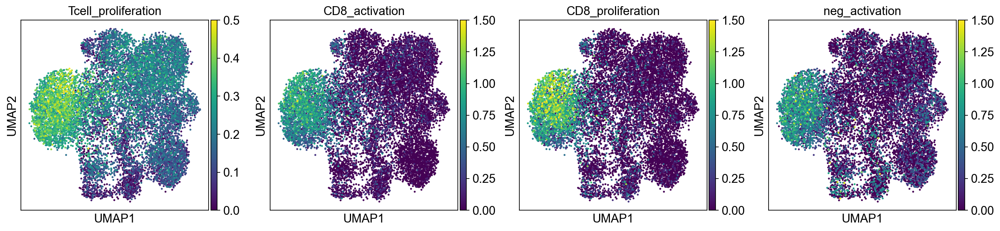

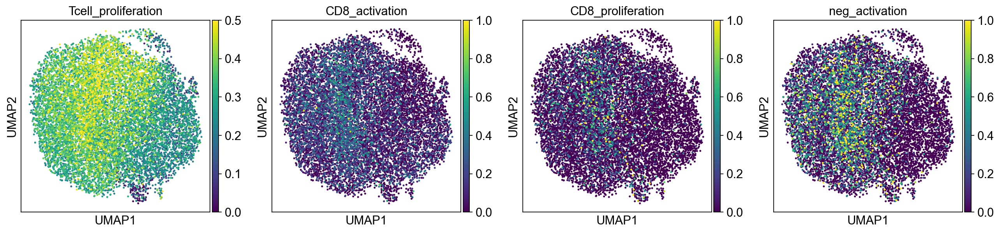

In [23]:
sc.pl.umap(adata, color=score_names, s=20, vmin=0, vmax=[.5,1.5,1.5,1.5])
sc.pl.umap(adata_II, color=score_names, s=20, vmin=0, vmax=[.5,1,1,1])

In [24]:
mean = adata.obs[adata.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').mean().iloc[interesting_clonotypes]
mean["EC50"]=EC50.EC50.tolist()
mean["Offrate"]=EC50.Offrate.tolist()
IFNG=[]
IFNG_percent=[]
GZMA=[]
for clonotype in interesting_clonotypes:
    IFNG.append(pd.DataFrame(adata[adata.obs.clonotype==clonotype,adata.var_names=="IFNG"].X).median().tolist()[0])
    GZMA.append(pd.DataFrame(adata[adata.obs.clonotype==clonotype,adata.var_names=="GZMA"].X).median().tolist()[0])
    IFNG_percent.append(((pd.DataFrame(adata[adata.obs.clonotype==clonotype,adata.var_names=="IFNG"].X)>0.5).sum().tolist()[0])/adata[adata.obs.clonotype==clonotype].shape[0])
mean["IFNG"]=IFNG
mean["GZMA"]=GZMA
mean["IFNG_percent"]=IFNG_percent
mean['clone']=["S13","S18","S28","S32","S40","S43","S82","S3398","S3399","S3409","S3456"]
mean['cluster']=[adata.obs[adata.obs.clonotype==x].ct_cluster_aa_alignment.astype(int).mean() for x in mean.index.astype(str).tolist()]
mean['leiden']=adata.obs[adata.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').agg({'leiden':lambda x:x.value_counts().index[0]}).iloc[interesting_clonotypes]
mean['leiden']=('Cluster '+mean.leiden.astype(str)).astype('category')
mean.cluster=('A'+mean.cluster.astype(str).str[:-2]).astype('category')

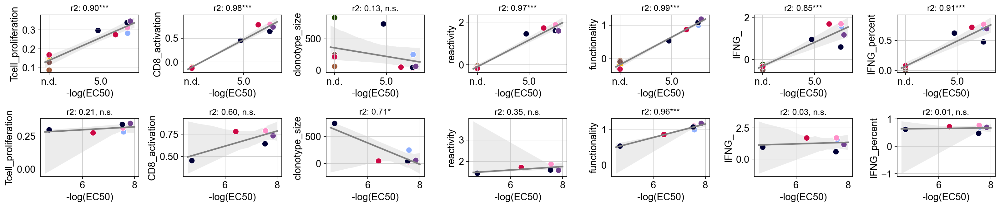

In [25]:
fig,ax=plt.subplots(nrows=2, ncols=7, figsize=(20,4))
fig.tight_layout(w_pad=2, h_pad=3)
for i, mean_df in enumerate([mean, mean[mean.EC50>0]]):
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean_df.index.tolist()]
    for j, var in enumerate(['Tcell_proliferation','CD8_activation', 'clonotype_size',
                             'reactivity','functionality', 'IFNG_', 'IFNG_percent']):
        sns.regplot(mean_df.EC50, mean_df[var], ax=ax[i,j], color='gray')
        sns.scatterplot(mean_df.EC50, mean_df[var], ax=ax[i,j], hue=mean_df.clone, legend=None, palette=colors, s=75)
        mask = ~np.isnan(mean_df.EC50) & ~np.isnan(mean_df[var])
        slope, intercept, r_value, p_value, std_err = stats.linregress(mean_df.EC50[mask], mean_df[var][mask])
        ax[i,j].set_title(label=('r2: %.2f' % r_value**2+convert_significance(p_value)), size=12)
        ax[i,j].set_xlabel('-log(EC50)')
        labels = ax[0,j].get_xticks().tolist()
        labels[1] = "n.d."
        ax[0,j].set_xticklabels(labels)
    
fig.savefig('./figures/correlations.svg',bbox_inches='tight', dpi=400)

In [26]:
correlation_data['r_squared'][correlation_data.r_squared<0.5]=0.5
correlation_data['correlation']='not significant'
correlation_data['correlation'][correlation_data.index.isin(functionality_genes)]='significantly pos'

In [27]:
correlation_data[correlation_data.correlation=='significantly pos']

,slope,intercept,r_value,p_value,std_err,r_squared,correlation
RGCC,0.379323,-1.491062,0.755932,0.082084,0.164250,0.571434,significantly pos
CD27,0.342895,-1.567841,0.931588,0.006860,0.066901,0.867857,significantly pos
XCL1,0.272327,-0.089827,0.778856,0.067949,0.109650,0.606617,significantly pos
NINJ1,0.236076,-1.115056,0.768846,0.073973,0.098170,0.591124,significantly pos
BICDL1,0.198273,-0.628081,0.803957,0.053882,0.073331,0.646347,significantly pos
FABP5,0.158676,0.517881,0.824073,0.043703,0.054539,0.679096,significantly pos
SLC7A6,0.127943,-0.409915,0.856933,0.029238,0.038478,0.734334,significantly pos
CD81,0.122536,-0.915646,0.708582,0.115012,0.061012,0.502088,significantly pos
KSR1,0.120200,-0.625919,0.829196,0.041269,0.040513,0.687566,significantly pos
HSPE1,0.109000,-0.002727,0.742133,0.091170,0.049221,0.550762,significantly pos


In [28]:
annotation=functionality_genes

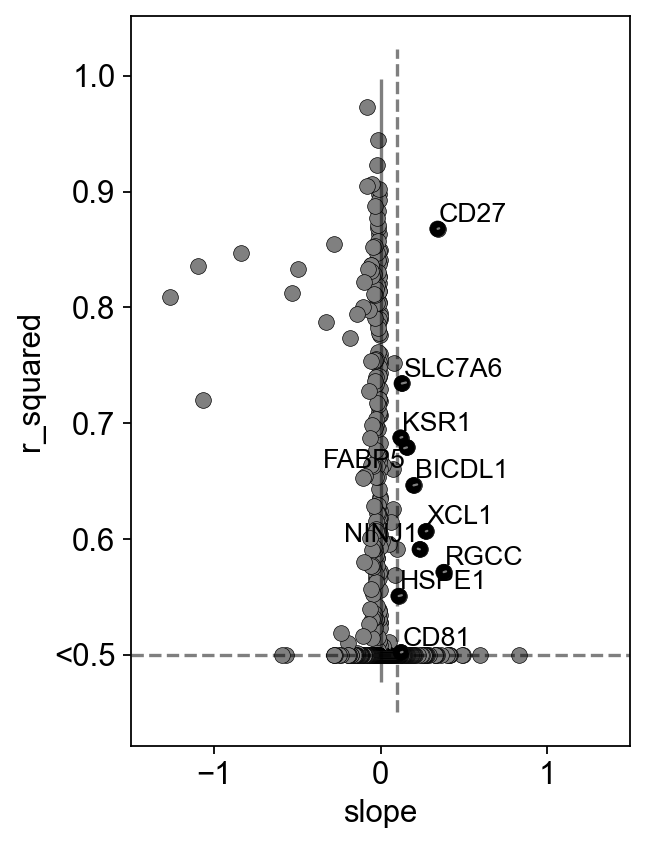

In [29]:
fig,ax=plt.subplots(figsize=(4,6))
sns.scatterplot(data=correlation_data, x='slope', y='r_squared', color='gray',ax=ax,
               edgecolor='black', linewidth=.3, s=50)
sns.scatterplot(data=correlation_data[correlation_data.correlation=='significantly pos'], x='slope', y='r_squared', hue='correlation', palette=['black'],ax=ax,
               edgecolor='black', linewidth=.3, s=50)
ax.set_xlim([-1.5,1.5])
text_values=[]
for line in range(0,correlation_data.shape[0]):
    if (correlation_data.iloc[line].correlation=='significantly pos')&(correlation_data.index[line] in annotation):
        text_values+=[ax.text(correlation_data.slope[line], correlation_data.r_squared[line], correlation_data.index[line],
                horizontalalignment='right', size=12, color='black')]
adjust_text(text_values, arrowprops=dict(arrowstyle='-', color='gray'), alpha=.5)
ax.vlines(x=0, ymin=ax.get_ylim()[0], ymax=ax.get_ylim()[1], alpha=.5)
ax.hlines(y=0.5, xmin=ax.get_xlim()[0], xmax=ax.get_xlim()[1], linestyles='--', alpha=.5)
ax.vlines(x=0.1, ymin=ax.get_ylim()[0], ymax=ax.get_ylim()[1], linestyles='--', alpha=.5)
ax.grid(False)
ax.get_legend().remove()
ax.set_xlabel('slope')
ax.set_ylabel('r_squared')
labels = ax.get_yticks().tolist()
#labels[4] = ">0.1"
ax.set_yticklabels(['','<0.5',0.6,0.7,0.8,0.9,1.0])
fig.savefig('./figures/volcano_functionality.svg', bbox_inches='tight')

In [30]:
adata_selected=adata_selected[:,~adata_selected.var_names.str.contains('TRA')]
adata_selected=adata_selected[:,~adata_selected.var_names.str.contains('TRB')]
adata_selected=adata_selected[:,~adata_selected.var_names.str.contains('TRG')]

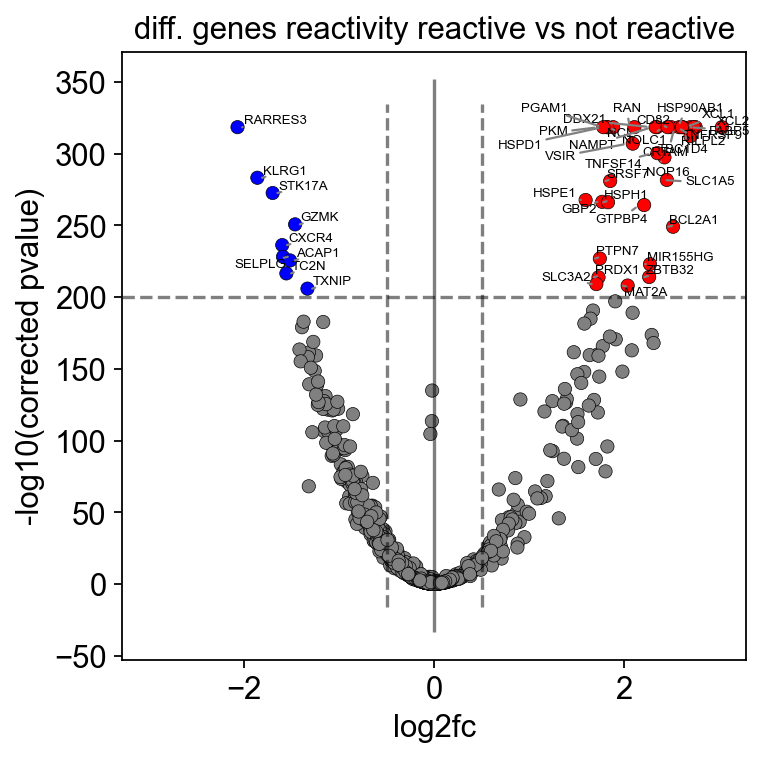

In [31]:
fig,ax=plt.subplots(figsize=(5,5))
genes=make_volcano_diffxpy(adata_selected, groupby='reactivity',return_genes=True,min_pval=200, ax=ax)

In [32]:
genes['annotation']='none'
genes['annotation'][genes.gene.isin(reactivity_genes)]='annotation'

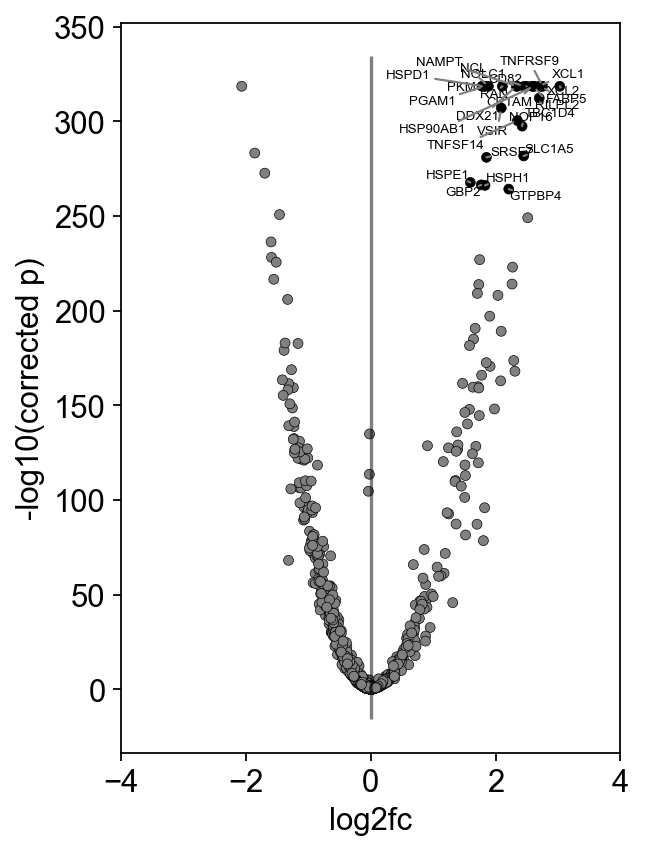

In [33]:
fig,ax=plt.subplots(figsize=(4,6))
sns.scatterplot(data=genes, x='log2fc', y='-log10(corrected pvalue)', hue='annotation', palette=['gray','black'],
               edgecolor='black', linewidth=.3, s=20, ax=ax)
text_values=[]
for line in range(0,genes.shape[0]):
    if (genes.iloc[line].annotation=='annotation'):
        text_values+=[ax.text(genes.log2fc[line], genes['-log10(corrected pvalue)'][line], genes.gene[line],
                horizontalalignment='right', size=6, color='black')]
adjust_text(text_values, arrowprops=dict(arrowstyle='-', color='gray'), alpha=.5)
ax.vlines(x=0, ymin=ax.get_ylim()[0], ymax=ax.get_ylim()[1], alpha=.5)
#ax.hlines(y=0.05, xmin=ax.get_xlim()[0], xmax=ax.get_xlim()[1], linestyles='--', alpha=.5)
ax.grid(False)
ax.get_legend().remove()
ax.set_xlabel('log2fc')
ax.set_ylabel('-log10(corrected p)')
ax.set_xlim([-4,4])
fig.savefig('./figures/volcano_reactivity.svg', bbox_inches='tight')

In [34]:
adata_corr=adata.copy()
for gene in functionality_genes:
    if gene in adata.raw.var_names:
        adata_corr.obs[gene]=[x[0] for x in adata_corr.raw[:,gene].X.todense().tolist()]

In [35]:
df_mean=adata_corr.obs.groupby('clonotype').mean()
df_mean=pd.merge(mean, df_mean, left_index=True, right_index=True, how='outer')
df_mean=df_mean[df_mean.index.isin(mean.index)]

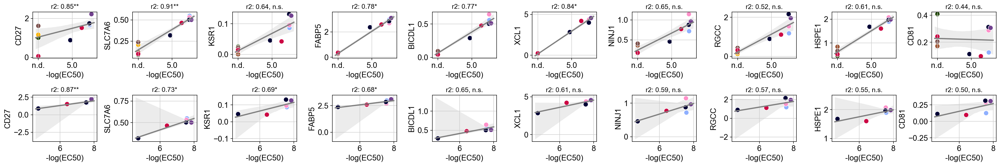

In [36]:
fig,ax=plt.subplots(ncols=10, nrows=2, figsize=(25,4))
fig.tight_layout(w_pad=2, h_pad=3)
score_names=['CD8_activation','CD8_proliferation']
for i, mean_df in enumerate([df_mean, df_mean[df_mean.EC50>0]]):
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean_df.index.tolist()]
    for j, var in enumerate(functionality_genes):
        if var in mean_df.columns.tolist():
            sns.regplot(mean_df.EC50, mean_df[var], ax=ax[i,j], color='gray')
            sns.scatterplot(mean_df.EC50, mean_df[var], ax=ax[i,j], hue=mean_df.clone, palette=colors, legend=None, s=75)
            mask = ~np.isnan(mean_df.EC50) & ~np.isnan(mean_df[var])
            slope, intercept, r_value, p_value, std_err = stats.linregress(mean_df.EC50[mask], mean_df[var][mask])
            ax[0,j].set_title(label=('r2: %.2f' % r_value**2+convert_significance(p_value)), size=12)
            ax[1,j].set_title(label=('r2: %.2f' % correlation_data.loc[var].r_value**2+convert_significance(correlation_data.loc[var].p_value)), size=12)
            ax[i,j].set_xlabel('-log(EC50)')
            labels = ax[0,j].get_xticks().tolist()
            labels[1] = "n.d."
            ax[0,j].set_xticklabels(labels)
fig.savefig('./figures/functionality_genes_selected.svg',bbox_inches='tight')

In [39]:
df=adata.obs.groupby('clonotype').agg({'clonotype_size':'mean', 'IFNG_':'mean',
                                    'batch':lambda x:x.value_counts().index[0],
                                    'donor':lambda x:x.value_counts().index[0],
                                    'leiden':lambda x:x.value_counts().index[0],
                                    'CD8_activation':'mean',
                                    'CD8_proliferation':'mean',
                                    'Tcell_proliferation':'mean',
                                    'functionality':'mean',
                                    'reactivity':'mean'})
df=df[df.clonotype_size>2]

In [40]:
mean['donor']=df[df.index.isin(mean.index)].donor

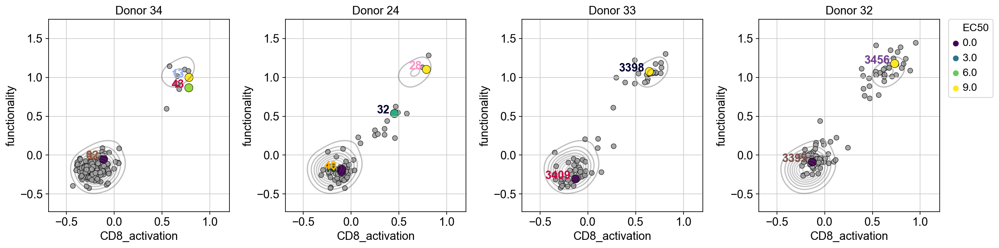

In [41]:
fig, ax=plt.subplots(ncols=4, figsize=(16,4))
fig.tight_layout(w_pad=2)
for i, donor in enumerate(['Donor 34','Donor 24','Donor 33','Donor 32']):
    sns.scatterplot(data=df[df.donor==donor], x='CD8_activation', y='functionality', color='darkgray', 
                    ax=ax[i], edgecolor='black', linewidth=.5)
    sns.scatterplot(data=mean[mean.donor==donor], x='CD8_activation', y='functionality', 
                    hue='EC50',
                    palette='viridis', ax=ax[i], s=100, edgecolor='black', linewidth=.5)
    ax[i].set_title(donor)
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean[mean.donor==donor].index.tolist()]
    for line in range(0,mean[mean.donor==donor].shape[0]):
        ax[i].text(mean[mean.donor==donor].CD8_activation[line]-0.05, mean[mean.donor==donor].functionality[line], mean[mean.donor==donor].index[line],
                horizontalalignment='right', size=14, color=colors[line], weight='bold')
    sns.kdeplot(data=df['CD8_activation'], data2=df['functionality'], color='gray', alpha=.3, ax=ax[i])
    ax[i].get_legend().remove()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
fig.savefig('./figures/CD8_act_vs_functionality_gray.svg',bbox_inches='tight')

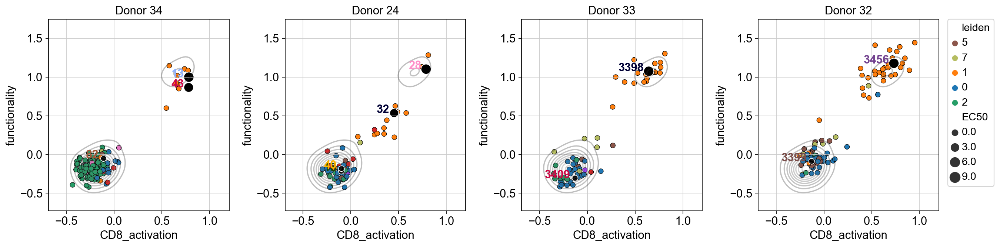

In [42]:
fig, ax=plt.subplots(ncols=4, figsize=(16,4))
fig.tight_layout(w_pad=2)
for i, donor in enumerate(['Donor 34','Donor 24','Donor 33','Donor 32']):
    colors=[adata.uns['leiden_colors'].tolist()[int(i)] for i in df[df.donor==donor].leiden.astype(int).unique()]
    sns.scatterplot(data=df[df.donor==donor], x='CD8_activation', y='functionality', hue='leiden', 
                    palette=colors, hue_order=df[df.donor==donor].leiden.unique(), ax=ax[i], edgecolor='black', linewidth=.5)
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean[mean.donor==donor].index.tolist()]
    sns.scatterplot(data=mean[mean.donor==donor], x='CD8_activation', y='functionality', 
                    size='EC50', color='black', sizes=(50,150),
                    ax=ax[i], s=100)
    ax[i].set_title(donor)
    for line in range(0,mean[mean.donor==donor].shape[0]):
        ax[i].text(mean[mean.donor==donor].CD8_activation[line]-0.05, mean[mean.donor==donor].functionality[line], mean[mean.donor==donor].index[line],
                horizontalalignment='right', size=14, color=colors[line], weight='bold')
    sns.kdeplot(data=df['CD8_activation'], data2=df['functionality'], color='gray', alpha=.3, ax=ax[i])
    ax[i].get_legend().remove()
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
fig.savefig('./figures/CD8_act_vs_functionality_leiden.svg',bbox_inches='tight')

In [43]:
df['functionality_score']=df['CD8_activation']*df['CD8_proliferation']

In [44]:
mean_score=df[(df.donor==donor)&(df.leiden=='1')].functionality_score.mean()
df['functionality_bin']='no'
df['functionality_bin'][(df.donor==donor)&(df.leiden=='1')&(df.functionality_score<mean_score)]='low'
df['functionality_bin'][(df.donor==donor)&(df.leiden=='1')&(df.functionality_score>mean_score)]='high'

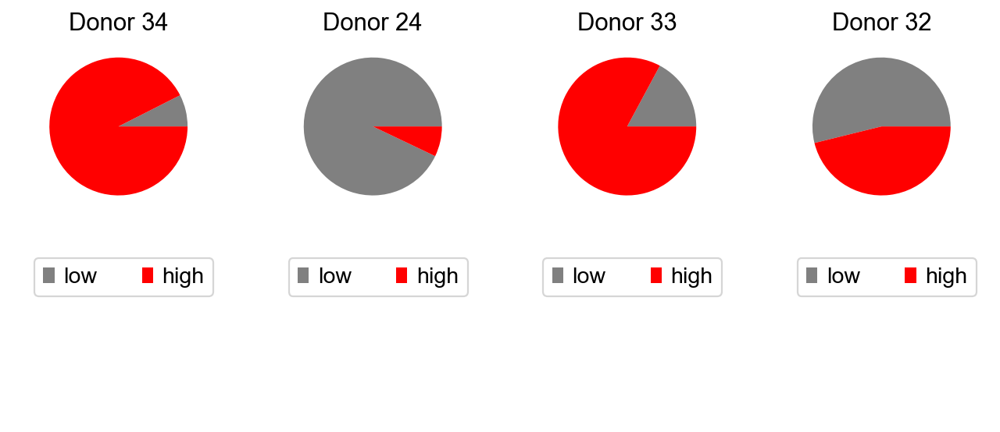

In [45]:
fig,ax=plt.subplots(ncols=4,nrows=2, figsize=(10,4))
for i, donor in enumerate(['Donor 34','Donor 24','Donor 33','Donor 32']):
    mean_score=df[(df.donor==donor)&(df.leiden=='1')].functionality_score.mean()
    df['functionality_bin']='no'
    df['functionality_bin'][(df.donor==donor)&(df.leiden=='1')&(df.functionality_score<mean_score)]='low'
    df['functionality_bin'][(df.donor==donor)&(df.leiden=='1')&(df.functionality_score>mean_score)]='high'
    high=df[(df.donor==donor)&(df.leiden=='1')&(df.functionality_bin=='high')].clonotype_size.sum()
    low=df[(df.donor==donor)&(df.leiden=='1')&(df.functionality_bin=='low')].clonotype_size.sum()
    patches, _=ax[0,i].pie([low,high], colors=['gray', 'red'])
    ax[0,i].set_title(donor)
    ax[1,i].legend(patches, ['low','high'], loc="best", ncol=4)
    ax[1,i].axis('off')
fig.savefig('./figures/functionalitydistribution_by_donor.svg',bbox_inches='tight')

In [46]:
df=adata.obs.groupby('clonotype').agg({'clonotype_size':'mean', 'IFNG_':'mean',
                                    'batch':lambda x:x.value_counts().index[0],
                                    'donor':lambda x:x.value_counts().index[0],
                                    'leiden':lambda x:x.value_counts().index[0],
                                    'CD8_activation':'mean',
                                    'CD8_proliferation':'mean'})

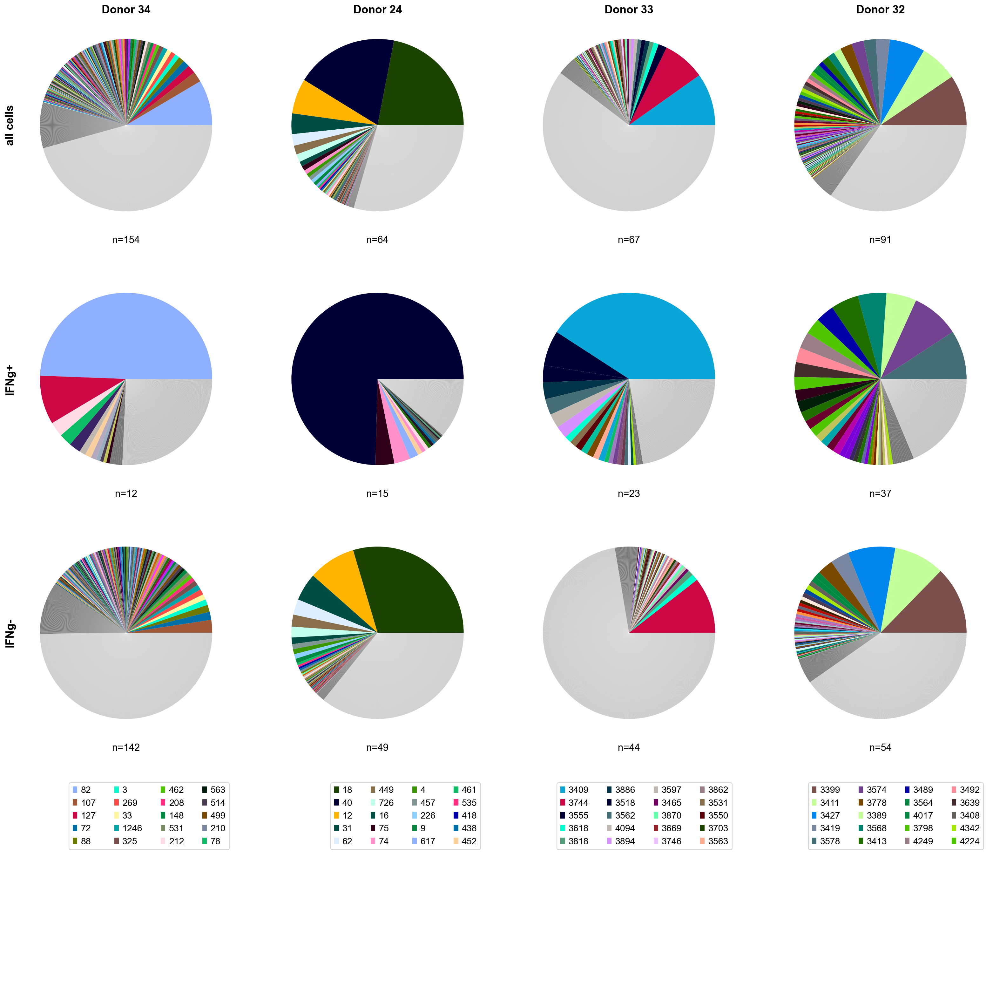

In [47]:
color_1='#c4c4c4'
color_2='#787878'
fig, ax=plt.subplots(ncols=4, nrows=4, figsize=(20,20))
fig.tight_layout(h_pad=2)
for i, donor in enumerate(['Donor 34','Donor 24','Donor 33','Donor 32']):
    df_temp=df[df.donor==donor].sort_values('clonotype_size', ascending=False)
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in df_temp.index.tolist()]
    colors[df_temp[df_temp.clonotype_size>2].shape[0]:]=[color_2]*len(colors[df_temp[df_temp.clonotype_size>2].shape[0]:])
    colors[df_temp[df_temp.clonotype_size>1].shape[0]:]=[color_1]*len(colors[df_temp[df_temp.clonotype_size>1].shape[0]:])
    patches, texts=ax[0,i].pie(df_temp.clonotype_size, colors=colors)
    ax[0,i].set_title(donor, weight='bold', size=16)
    ax[0,0].set_ylabel('all cells', weight='bold', size=16)
    ax[0,i].set_xlabel('n='+str(df_temp[df_temp.clonotype_size>2].shape[0]))
    
    df_temp=df[(df.donor==donor)&(df.leiden=='1')].sort_values('clonotype_size', ascending=False)
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in df_temp.index.tolist()]
    colors[df_temp[df_temp.clonotype_size>2].shape[0]:]=[color_2]*len(colors[df_temp[df_temp.clonotype_size>2].shape[0]:])
    colors[df_temp[df_temp.clonotype_size>1].shape[0]:]=[color_1]*len(colors[df_temp[df_temp.clonotype_size>1].shape[0]:])
    ax[1,i].pie(df_temp.clonotype_size, colors=colors)
    ax[1,0].set_ylabel('IFNg+', weight='bold', size=16)
    ax[1,i].set_xlabel('n='+str(df_temp[df_temp.clonotype_size>2].shape[0]))
    
    df_temp=df[(df.donor==donor)&(df.leiden!='1')].sort_values('clonotype_size', ascending=False)
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in df_temp.index.tolist()]
    colors[df_temp[df_temp.clonotype_size>2].shape[0]:]=[color_2]*len(colors[df_temp[df_temp.clonotype_size>2].shape[0]:])
    colors[df_temp[df_temp.clonotype_size>1].shape[0]:]=[color_1]*len(colors[df_temp[df_temp.clonotype_size>1].shape[0]:])
    ax[2,i].pie(df_temp.clonotype_size, colors=colors)
    ax[2,0].set_ylabel('IFNg-', weight='bold', size=16)
    ax[2,i].set_xlabel('n='+str(df_temp[df_temp.clonotype_size>2].shape[0]))
    ax[3,i].legend(patches[:20], df_temp.index[:20].tolist(), loc="best", ncol=4)
    ax[3,i].axis('off')
    
fig.savefig('./figures/pie_charts_experiment_1.svg',bbox_inches='tight')
plt.show()

In [48]:
df_2=adata_II.obs.groupby('clonotype').agg({'clonotype_size':'mean', 'IFNG_':'mean',
                                    'batch':lambda x:x.value_counts().index[0],
                                    'samplename':lambda x:x.value_counts().index[0],
                                    'leiden':lambda x:x.value_counts().index[0],
                                    'CD8_activation':'mean',
                                    'CD8_proliferation':'mean',
                                    'Tcell_proliferation':'mean',
                                           'functionality':'mean',
                                           'reactivity':'mean'})

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  del sys.path[0]
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:21: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:13: UserWar

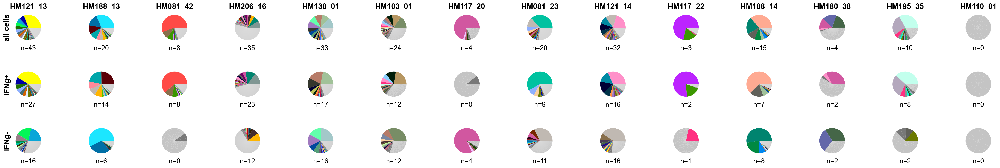

In [49]:
fig, ax=plt.subplots(ncols=14, nrows=3, figsize=(30,5))
fig.tight_layout(h_pad=2)
for i, donor in enumerate(df_2.samplename.unique()):
    df_temp=df_2[df_2.samplename==donor].sort_values('clonotype_size', ascending=False)
    colors=[adata_II.uns['clonotype_colors'].tolist()[int(i)] for i in df_temp.index.tolist()]
    colors[df_temp[df_temp.clonotype_size>2].shape[0]:]=[color_2]*len(colors[df_temp[df_temp.clonotype_size>2].shape[0]:])
    colors[df_temp[df_temp.clonotype_size>1].shape[0]:]=[color_1]*len(colors[df_temp[df_temp.clonotype_size>1].shape[0]:])
    patches, texts=ax[0,i].pie(df_temp.clonotype_size, colors=colors)
    ax[0,i].set_title(donor, weight='bold', size=16)
    ax[0,0].set_ylabel('all cells', weight='bold', size=16)
    ax[0,i].set_xlabel('n='+str(df_temp[df_temp.clonotype_size>2].shape[0]))
    
    df_temp=df_2[(df_2.samplename==donor)&(df.leiden.isin(['0','1','2','5']))].sort_values('clonotype_size', ascending=False)
    colors=[adata_II.uns['clonotype_colors'].tolist()[int(i)] for i in df_temp.index.tolist()]
    colors[df_temp[df_temp.clonotype_size>2].shape[0]:]=[color_2]*len(colors[df_temp[df_temp.clonotype_size>2].shape[0]:])
    colors[df_temp[df_temp.clonotype_size>1].shape[0]:]=[color_1]*len(colors[df_temp[df_temp.clonotype_size>1].shape[0]:])
    ax[1,i].pie(df_temp.clonotype_size, colors=colors)
    ax[1,0].set_ylabel('IFNg+', weight='bold', size=16)
    ax[1,i].set_xlabel('n='+str(df_temp[df_temp.clonotype_size>2].shape[0]))
    
    df_temp=df_2[(df_2.samplename==donor)&(~df.leiden.isin(['0','1','2','5']))].sort_values('clonotype_size', ascending=False)
    colors=[adata_II.uns['clonotype_colors'].tolist()[int(i)] for i in df_temp.index.tolist()]
    colors[df_temp[df_temp.clonotype_size>2].shape[0]:]=[color_2]*len(colors[df_temp[df_temp.clonotype_size>2].shape[0]:])
    colors[df_temp[df_temp.clonotype_size>1].shape[0]:]=[color_1]*len(colors[df_temp[df_temp.clonotype_size>1].shape[0]:])
    ax[2,i].pie(df_temp.clonotype_size, colors=colors)
    ax[2,0].set_ylabel('IFNg-', weight='bold', size=16)
    ax[2,i].set_xlabel('n='+str(df_temp[df_temp.clonotype_size>2].shape[0]))
    #ax[3,i].legend(patches[:10], df_temp.index[:10].tolist(), loc="best", ncol=2)
    #ax[3,i].axis('off')
    
fig.savefig('./figures/pie_charts_experiment_2.svg',bbox_inches='tight')
plt.show()

In [50]:
df=df_2[df_2.clonotype_size>2]

In [51]:
df['IFNg_cluster']='not_assigned'
df['IFNg_cluster'][df.leiden.isin(['3','6','7','8'])]='IFNg_low'
df['IFNg_cluster'][df.leiden.isin(['4','0'])]='IFNg_int'
df['IFNg_cluster'][df.leiden.isin(['2','1','5'])]='IFNg_high'

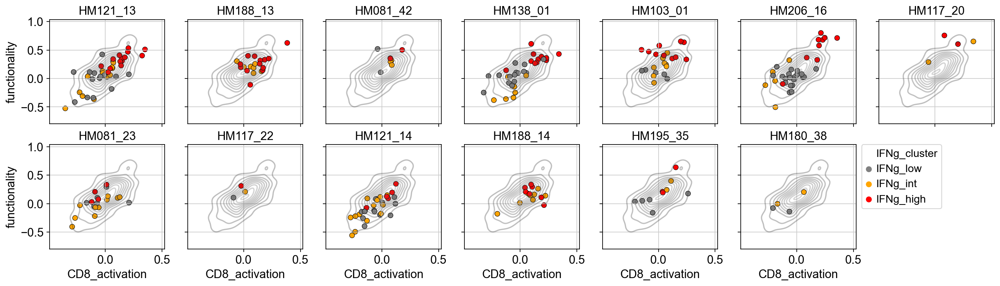

In [52]:
fig, ax=plt.subplots(ncols=7, nrows=2, figsize=(20,5), sharey=True, sharex=True)
for i, donor in enumerate(df.samplename.unique()):
    sns.scatterplot(data=df[df.samplename==donor], x='CD8_activation', y='functionality', hue='IFNg_cluster', 
                    palette=['gray','orange','red'], hue_order=['IFNg_low','IFNg_int','IFNg_high'], ax=ax.reshape(-1)[i],
                    edgecolor='black', linewidth=.5)
    ax.reshape(-1)[i].set_title(donor)
    sns.kdeplot(data=df['CD8_activation'], data2=df['functionality'], color='gray', alpha=.3, ax=ax.reshape(-1)[i])
    ax.reshape(-1)[i].get_legend().remove()
ax.reshape(-1)[i].legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
ax.reshape(-1)[i+1].axis('off')
fig.savefig('./figures/Figure_6D_Tcell_prolif.svg',bbox_inches='tight')

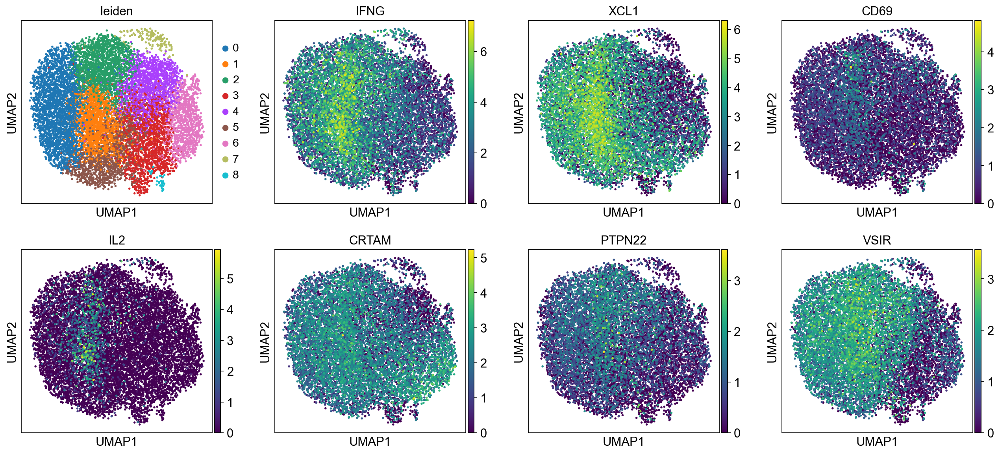

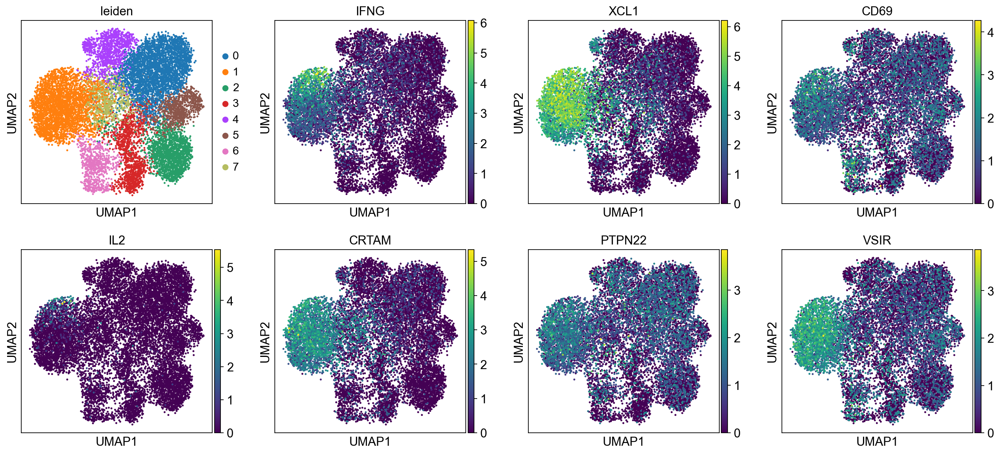

In [53]:
sc.pl.umap(adata_II, color=['leiden','IFNG','XCL1','CD69','IL2','CRTAM','PTPN22','VSIR'], s=25, save='_experiment_1.svg')
sc.pl.umap(adata, color=['leiden','IFNG','XCL1','CD69','IL2','CRTAM','PTPN22','VSIR'], s=20, save='_experiment_2.svg')

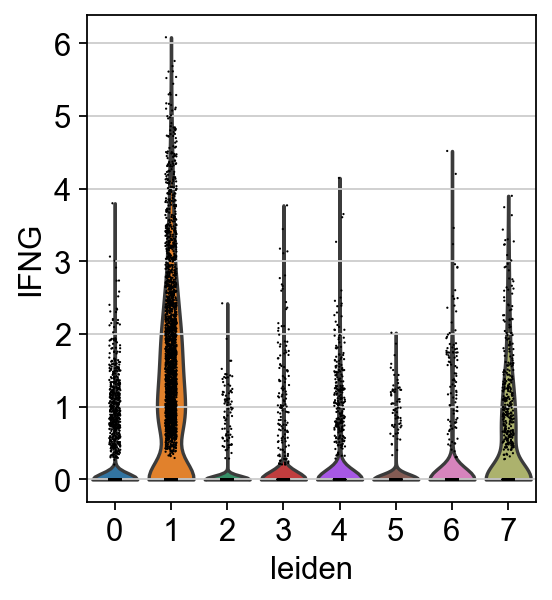

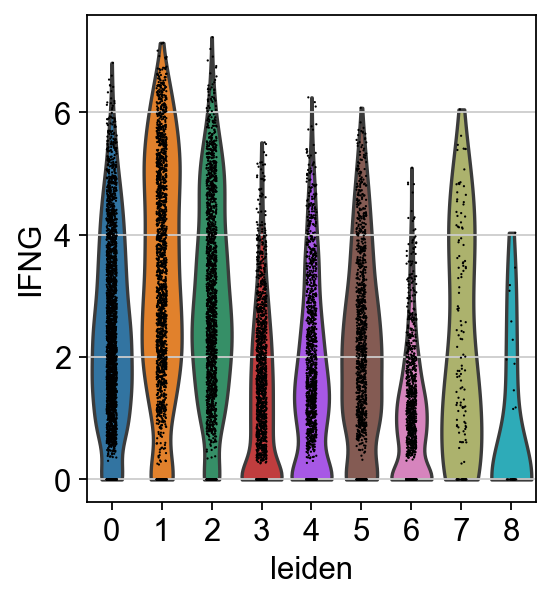

In [54]:
sc.pl.violin(adata, keys='IFNG', groupby='leiden')
sc.pl.violin(adata_II, keys='IFNG', groupby='leiden')

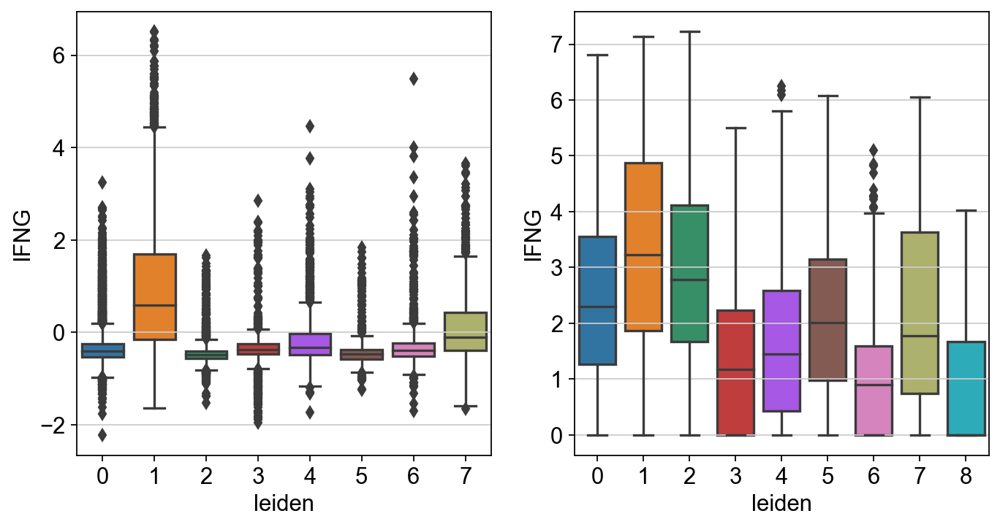

In [55]:
fig,ax=plt.subplots(ncols=2, figsize=(10,5))
sns.boxplot(data=adata.obs, x='leiden', y='IFNG_', ax=ax[0])
sns.boxplot(data=adata_II.obs, x='leiden', y='IFNG_', ax=ax[1])
for ax in ax:
    ax.set_ylabel('IFNG')
fig.savefig('./figures/IFNg_vs_leiden.svg',bbox_inches='tight')

In [56]:
adata_corr=adata.copy()
score_names=['CD8_activation','CD8_proliferation']
scorelist=[]
for score in score_names:
    scorelist+=pd.read_csv('F:/10x_data_COVID_II/analysis_info/'+score+'.txt', sep='\t', header=None).T[2:].iloc[:,0].tolist()
    for gene in scorelist:
        if gene in adata.raw.var_names:
            adata_corr.obs[gene]=[x[0] for x in adata_corr.raw[:,gene].X.todense().tolist()]

In [57]:
df_mean=adata_corr.obs.groupby('clonotype').mean()
df_mean=pd.merge(mean, df_mean, left_index=True, right_index=True, how='outer')
df_mean=df_mean[df_mean.index.isin(mean.index)]

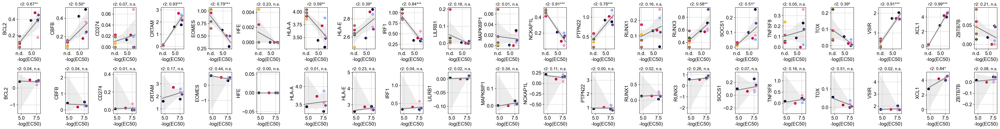

In [58]:
fig,ax=plt.subplots(ncols=21, nrows=2, figsize=(40,5))
fig.tight_layout(w_pad=2, h_pad=3)
score_names=['CD8_activation','CD8_proliferation']
for i, mean_df in enumerate([df_mean, df_mean[df_mean.EC50>0]]):
    colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean_df.index.tolist()]
    for j, var in enumerate(mean_df.columns.tolist()[-21:]):
        if var in mean_df.columns.tolist():
            sns.regplot(mean_df.EC50, mean_df[var], ax=ax[i,j], color='gray')
            sns.scatterplot(mean_df.EC50, mean_df[var], ax=ax[i,j], hue=mean_df.clone, palette=colors, legend=None, s=75)
            mask = ~np.isnan(mean_df.EC50) & ~np.isnan(mean_df[var])
            slope, intercept, r_value, p_value, std_err = stats.linregress(mean_df.EC50[mask], mean_df[var][mask])
            ax[i,j].set_title(label=('r2: %.2f' % r_value**2+convert_significance(p_value)), size=12)
            ax[i,j].set_xlabel('-log(EC50)')
            labels = ax[0,j].get_xticks().tolist()
            labels[1] = "n.d."
            ax[0,j].set_xticklabels(labels)
fig.savefig('./figures/single_score_genes.svg',bbox_inches='tight')

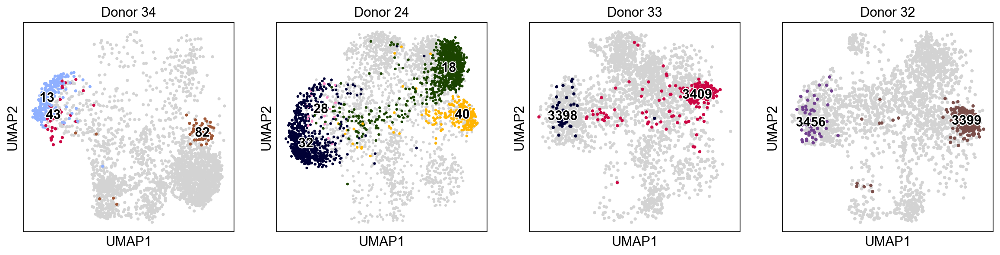

In [59]:
fig,ax=plt.subplots(ncols=4, figsize=(18,4))
for i, data in enumerate(single_donor_adatas):
    #sc.pl.umap(data, color='clonotype', 
    #            groups=data.obs.clonotype.value_counts()[:10].index.tolist(),
    #            legend_loc=None, legend_fontoutline=2, ax=ax[i], show=False)
    sc.pl.umap(data, color='clonotype', 
                groups=EC50[EC50.index.isin(data.obs.groupby('clonotype')['leiden'].count().sort_values(ascending=False)[:10].index.tolist())].index.astype(str).tolist(),
                legend_loc='on data', legend_fontoutline=2, ax=ax[i], show=False, alpha=1, title=single_donor_adatas_names[i])
    fig.savefig('./figures/functional_clonotypes.svg', bbox_inches='tight')

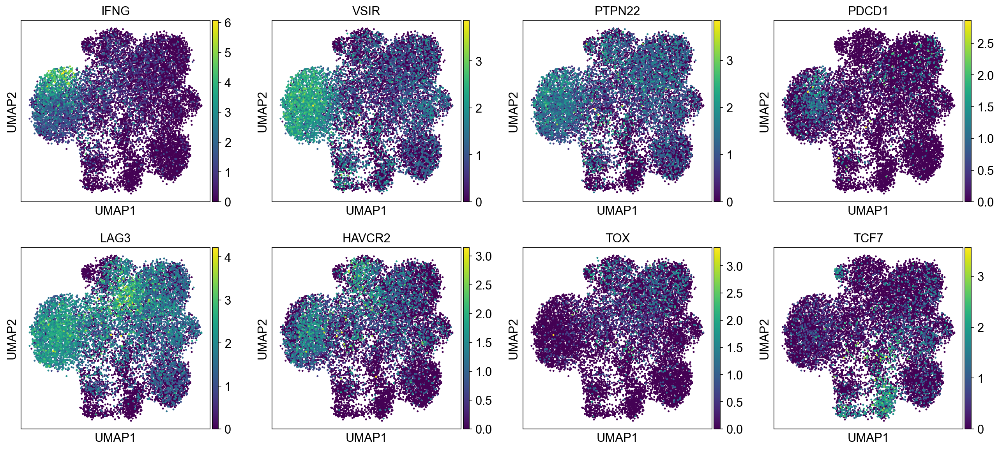

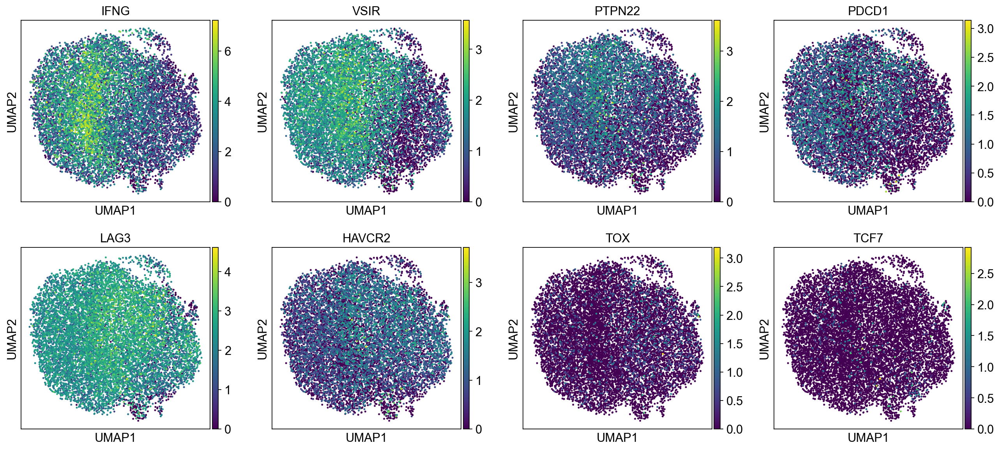

In [60]:
sc.pl.umap(adata, color=['IFNG','VSIR','PTPN22','PDCD1','LAG3','HAVCR2','TOX','TCF7'], s=20, save='_exhaustion_I.svg')
sc.pl.umap(adata_II, color=['IFNG','VSIR','PTPN22','PDCD1','LAG3','HAVCR2','TOX','TCF7'], s=20, save='_exhaustion_II.svg')

In [61]:
merged_data=adata.concatenate(adata_II, batch_key='experiment', batch_categories=['1','2'])

In [62]:
score_names=['Tcell_proliferation','CD8_activation','CD8_proliferation', 'neg_activation']
for score in score_names:
    scorelist=pd.read_csv('F:/10x_data_COVID_II/analysis_info/'+score+'.txt', sep='\t', header=None).T[2:].iloc[:,0].tolist()
    sc.tl.score_genes(merged_data, scorelist, score_name=score)

In [63]:
sc.tl.score_genes(merged_data, reactivity_genes, score_name='reactivity')
sc.tl.score_genes(merged_data, functionality_genes, score_name='functionality')

In [64]:
sc.tl.pca(merged_data, svd_solver='arpack')

In [65]:
sc.pp.neighbors(merged_data, n_neighbors=10, n_pcs=7)
sc.tl.umap(merged_data)

... storing 'cluster' as categorical
... storing 'leiden' as categorical
... storing 'donor' as categorical
... storing 'TRA_1_cdr3' as categorical
... storing 'TRA_2_cdr3' as categorical
... storing 'TRB_1_cdr3' as categorical
... storing 'TRB_2_cdr3' as categorical
... storing 'TRA_1_junction_ins' as categorical
... storing 'TRA_2_junction_ins' as categorical
... storing 'TRB_1_junction_ins' as categorical
... storing 'TRB_2_junction_ins' as categorical
... storing 'TRA_1_v_gene' as categorical
... storing 'TRA_2_v_gene' as categorical
... storing 'TRB_1_v_gene' as categorical
... storing 'TRB_2_v_gene' as categorical
... storing 'TRA_1_d_gene' as categorical
... storing 'TRA_2_d_gene' as categorical
... storing 'TRB_1_d_gene' as categorical
... storing 'TRB_2_d_gene' as categorical
... storing 'TRA_1_j_gene' as categorical
... storing 'TRA_2_j_gene' as categorical
... storing 'TRB_2_j_gene' as categorical
... storing 'TRA_1_c_gene' as categorical
... storing 'TRA_2_c_gene' as catego

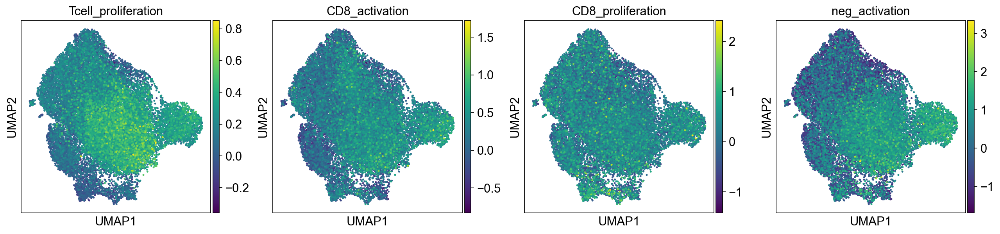

In [66]:
sc.pl.umap(merged_data, color=score_names, s=20)

In [67]:
merged_data.obs.clonotype=merged_data.obs.clonotype.astype(str)
merged_data.obs.clonotype[merged_data.obs.experiment=='2']=merged_data.obs.clonotype[merged_data.obs.experiment=='2'].astype(str)+'_II'
merged_data.obs.donor=merged_data.obs.donor.astype(str)
merged_data.obs.donor[merged_data.obs.experiment=='2']=merged_data.obs.samplename[merged_data.obs.experiment=='2']

In [68]:
df=merged_data.obs.groupby('clonotype').agg({'clonotype_size':'mean', 'IFNG_':'mean',
                                    'batch':lambda x:x.value_counts().index[0],
                                    'donor':lambda x:x.value_counts().index[0],
                                    'leiden':lambda x:x.value_counts().index[0],
                                    'experiment':lambda x:x.value_counts().index[0],
                                    'CD8_activation':'mean',
                                    'CD8_proliferation':'mean',
                                    'Tcell_proliferation':'mean',
                                            'reactivity':'mean',
                                            'functionality':'mean'})
df=df[df.clonotype_size>2]

In [69]:
sc.settings.verbosity=0
mean = merged_data.obs[merged_data.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').mean().loc[interesting_clonotypes]
mean["EC50"]=EC50.EC50.tolist()
mean["Offrate"]=EC50.Offrate.tolist()
mean['clone']=["S13","S18","S28","S32","S40","S43","S82","S3398","S3399","S3409","S3456"]
mean['leiden']=merged_data.obs[merged_data.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').agg({'leiden':lambda x:x.value_counts().index[0]}).loc[interesting_clonotypes]
mean['leiden']=('Cluster '+mean.leiden.astype(str)).astype('category')

In [70]:
mean['donor']=df[df.index.isin(mean.index)].donor

In [71]:
df_original=df.copy()

In [72]:
import matplotlib.patheffects as path_effects

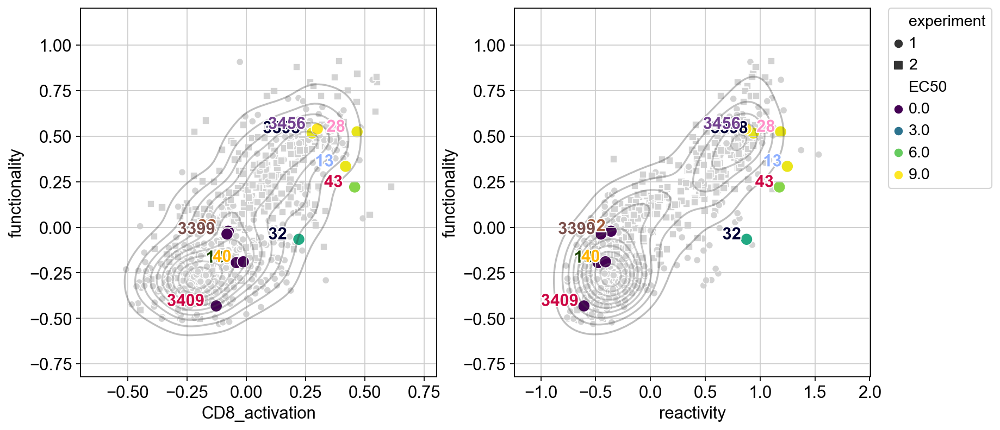

In [73]:
fig, ax=plt.subplots(ncols=2, figsize=(10,5))
fig.tight_layout(w_pad=2)
df=df_original.copy()
sns.scatterplot(data=df, x='CD8_activation', y='functionality', color='lightgray', 
                    ax=ax[0], style='experiment', markers=['o','s'])
sns.scatterplot(data=mean, x='CD8_activation', y='functionality', 
                    hue='EC50',
                    palette='viridis', ax=ax[0], legend=False, s=100)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[0].text(mean.CD8_activation[line]-0.05, mean.functionality[line], mean.index[line],
                horizontalalignment='right', size=14, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
sns.kdeplot(data=df['CD8_activation'], data2=df['functionality'], color='gray', alpha=.3, ax=ax[0])
ax[0].get_legend().remove()
sns.scatterplot(data=df, x='reactivity', y='functionality', color='lightgray', 
                    ax=ax[1], style='experiment', markers=['o','s'])
sns.scatterplot(data=mean, x='reactivity', y='functionality', 
                    hue='EC50',
                    palette='viridis', ax=ax[1], s=100)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[1].text(mean.reactivity[line]-0.05, mean.functionality[line], mean.index[line],
                horizontalalignment='right', size=14, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
sns.kdeplot(data=df['reactivity'], data2=df['functionality'], color='gray', alpha=.3, ax=ax[1])

ax[1].legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
fig.savefig('./figures/scores_reactivity_vs_functionality.svg',bbox_inches='tight')

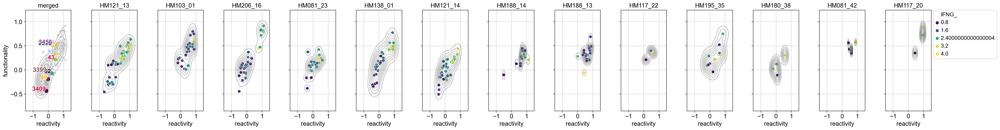

In [74]:
fig, ax=plt.subplots(ncols=14, figsize=(30,4), sharey=True)
fig.tight_layout(w_pad=2)
df=df_original[df_original.experiment=='2'].copy()
sns.scatterplot(data=df, x='reactivity', y='functionality', color='lightgray', 
                    ax=ax[0], style='experiment', markers=['o','s'])
sns.scatterplot(data=mean, x='CD8_activation', y='functionality', 
                    hue='EC50',
                    palette='viridis', ax=ax[0], legend=False, s=100)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[0].text(mean.CD8_activation[line]-0.05, mean.functionality[line], mean.index[line],
                horizontalalignment='right', size=14, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
sns.kdeplot(data=df_original['reactivity'], data2=df_original['functionality'], color='gray', alpha=.3, ax=ax[0])
ax[0].get_legend().remove()
ax[0].set_title('merged')
ax[0].set_xlim([-1.5,1.5])
for i, donor in enumerate(df.donor.unique().tolist()):
    sns.scatterplot(data=df[df.donor==donor], x='reactivity', y='functionality', hue='IFNG_', palette='viridis', ax=ax[i+1], s=50)
    sns.kdeplot(data=df[df.donor==donor]['reactivity'], data2=df[df.donor==donor]['functionality'], color='gray', alpha=.3, ax=ax[i+1])
    ax[i+1].set_title(donor)
    ax[i+1].set_xlim([-1.5,1.5])
    ax[i+1].get_legend().remove()
ax[-1].legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
fig.savefig('./figures/single_donor_functionality_reactivity_IFNG_expr.svg',bbox_inches='tight')

In [75]:
df['IFNg_cluster']='not_assigned'
df['IFNg_cluster'][(df.experiment=='2') & (df.leiden.isin(['3','6','7','8']))]='IFNg_low'
df['IFNg_cluster'][(df.experiment=='2') & (df.leiden.isin(['4','0']))]='IFNg_int'
df['IFNg_cluster'][(df.experiment=='2') & (df.leiden.isin(['2','1','5']))]='IFNg_high'
df['IFNg_cluster'][(df.experiment=='1') & (df.leiden.isin(['1']))]='IFNg_high'
df['IFNg_cluster'][(df.experiment=='1') & (~df.leiden.isin(['1']))]='IFNg_low'

In [76]:
third_ifng=((adata_II.obs.IFNG_.median()-adata_II.obs.IFNG_.min())*2)/3

In [77]:
np.percentile(adata_II.obs.IFNG_, (1/3)*100)

1.2606761455535889

In [78]:
third_ifng=np.percentile(adata_II.obs.IFNG_, (1/3)*100)

In [79]:
df['IFNg_cluster']='not_assigned'
df['IFNg_cluster'][(df.experiment=='2') & (df.IFNG_<third_ifng)]='IFNg_low'
df['IFNg_cluster'][(df.experiment=='2') & (df.IFNG_>third_ifng) & (df.IFNG_<2*third_ifng)]='IFNg_int'
df['IFNg_cluster'][(df.experiment=='2') & (df.IFNG_>2*third_ifng)]='IFNg_high'

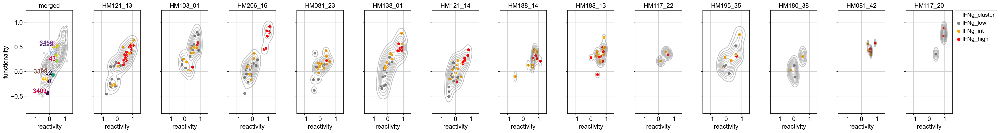

In [80]:
fig, ax=plt.subplots(ncols=14, figsize=(30,4), sharey=True)
fig.tight_layout(w_pad=2)
sns.scatterplot(data=df, x='reactivity', y='functionality', color='lightgray', 
                    ax=ax[0], style='experiment', markers=['o','s'])
sns.scatterplot(data=mean, x='CD8_activation', y='functionality', 
                    hue='EC50',
                    palette='viridis', ax=ax[0], legend=False, s=100)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[0].text(mean.CD8_activation[line]-0.05, mean.functionality[line], mean.index[line],
                horizontalalignment='right', size=14, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
sns.kdeplot(data=df['reactivity'], data2=df['functionality'], color='gray', alpha=.3, ax=ax[0])
ax[0].get_legend().remove()
ax[0].set_title('merged')
ax[0].set_xlim([-1.5,1.5])
for i, donor in enumerate(df.donor.unique().tolist()):
    sns.scatterplot(data=df[df.donor==donor], x='reactivity', y='functionality', hue='IFNg_cluster', 
                    palette=['gray','orange','red'], hue_order=['IFNg_low','IFNg_int','IFNg_high'], ax=ax[i+1], s=50)
    sns.kdeplot(data=df[df.donor==donor]['reactivity'], data2=df[df.donor==donor]['functionality'], color='gray', alpha=.3, ax=ax[i+1])
    ax[i+1].set_title(donor)
    ax[i+1].set_xlim([-1.5,1.5])
    ax[i+1].get_legend().remove()
ax[-1].legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
fig.savefig('./figures/single_donor_functionality_reactivity_IFNG_group.svg',bbox_inches='tight')

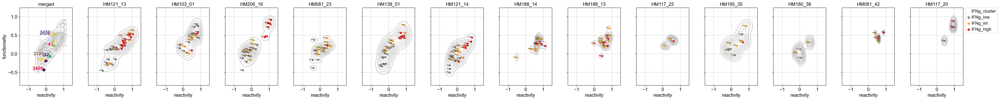

In [81]:
fig, ax=plt.subplots(ncols=14, figsize=(40,4), sharey=True)
fig.tight_layout(w_pad=2)
sns.scatterplot(data=df, x='reactivity', y='functionality', color='lightgray', 
                    ax=ax[0], style='experiment', markers=['o','s'])
sns.scatterplot(data=mean, x='CD8_activation', y='functionality', 
                    hue='EC50',
                    palette='viridis', ax=ax[0], legend=False, s=100)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[0].text(mean.CD8_activation[line]-0.05, mean.functionality[line], mean.index[line],
                horizontalalignment='right', size=14, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
sns.kdeplot(data=df['reactivity'], data2=df['functionality'], color='gray', alpha=.3, ax=ax[0])
ax[0].get_legend().remove()
ax[0].set_title('merged')
ax[0].set_xlim([-1.5,1.5])
for i, donor in enumerate(df.donor.unique().tolist()):
    sns.scatterplot(data=df[df.donor==donor], x='reactivity', y='functionality', hue='IFNg_cluster', 
                    palette=['gray','orange','red'], hue_order=['IFNg_low','IFNg_int','IFNg_high'], ax=ax[i+1], s=50)
    sns.kdeplot(data=df[df.donor==donor]['reactivity'], data2=df[df.donor==donor]['functionality'], color='gray', alpha=.3, ax=ax[i+1])
    for line in range(0,df[df.donor==donor].shape[0]):
        txt=ax[i+1].text(df[df.donor==donor].reactivity[line]-0.05, df[df.donor==donor].functionality[line], [x[0] for x in df[df.donor==donor].index.str.split('_')][line],
                horizontalalignment='right', size=4)
    ax[i+1].set_title(donor)
    ax[i+1].set_xlim([-1.5,1.5])
    ax[i+1].get_legend().remove()
ax[-1].legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
fig.savefig('./figures/single_donor_functionality_reactivity_IFNG_group_annot.svg',bbox_inches='tight')

In [82]:
df['functionality_x_reactivity']=df['functionality']*df['reactivity']

In [83]:
median_func_reac=df['functionality_x_reactivity'].median()

In [85]:
df['functional_property']='none'
df['functional_property'][df['functionality_x_reactivity']>median_func_reac]='high'
df['functional_property'][df['functionality_x_reactivity']<median_func_reac]='low'

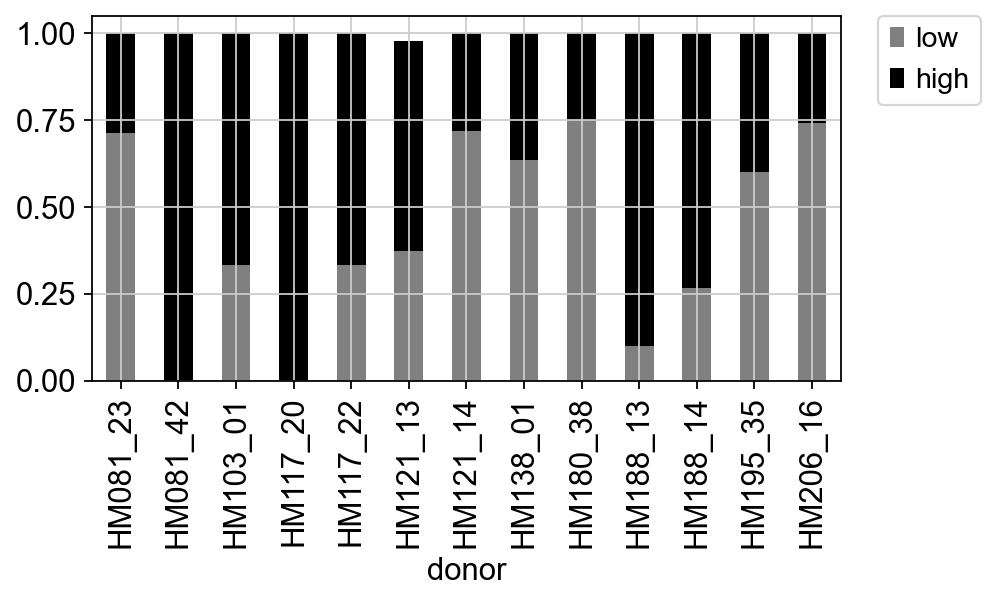

In [88]:
fig,ax=plt.subplots(figsize=(6,3))
pd.crosstab(df.donor, df.functional_property).apply(lambda r: r/r.sum(), axis=1)[['low','high']].plot(kind='bar', stacked=True, color=['gray','black'], ax=ax)
ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.show()
fig.savefig('./figures/functional properties.svg',bbox_inches='tight')

In [91]:
df=merged_data.obs.groupby('clonotype').agg({'clonotype_size':'mean', 'IFNG_':'mean',
                                    'batch':lambda x:x.value_counts().index[0],
                                    'donor':lambda x:x.value_counts().index[0],
                                    'leiden':lambda x:x.value_counts().index[0],
                                    'experiment':lambda x:x.value_counts().index[0],
                                    'CD8_activation':'mean',
                                    'CD8_proliferation':'mean',
                                    'Tcell_proliferation':'mean',
                                    'functionality':'mean',
                                    'reactivity':'mean'})
df=df[df.clonotype_size>2]
df_original=df.copy()

In [92]:
sc.settings.verbosity=0
mean = merged_data.obs[merged_data.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').mean().loc[interesting_clonotypes]
mean["EC50"]=EC50.EC50.tolist()
mean["Offrate"]=EC50.Offrate.tolist()
mean['clone']=["S13","S18","S28","S32","S40","S43","S82","S3398","S3399","S3409","S3456"]
mean['leiden']=merged_data.obs[merged_data.obs.clonotype.isin(interesting_clonotypes)].groupby('clonotype').agg({'leiden':lambda x:x.value_counts().index[0]}).loc[interesting_clonotypes]
mean['leiden']=('Cluster '+mean.leiden.astype(str)).astype('category')
mean['experiment']=1

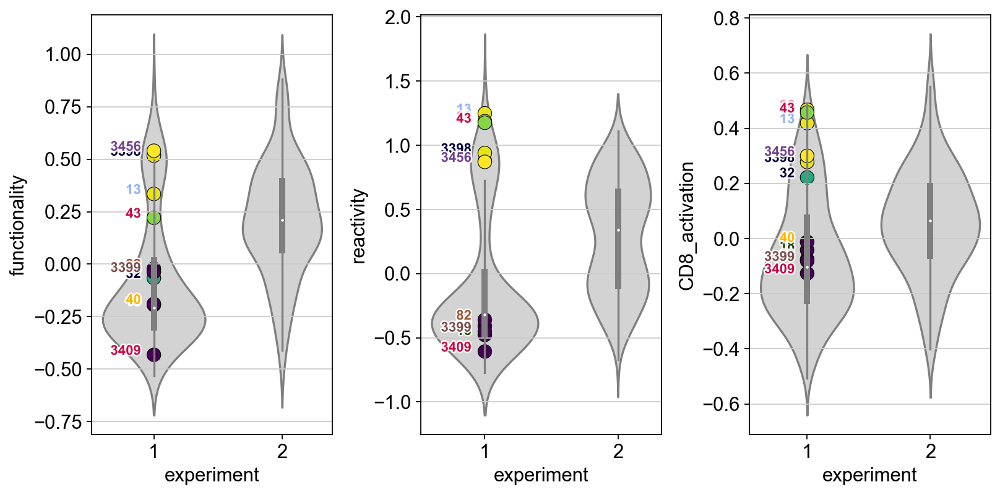

In [93]:
fig, ax=plt.subplots(ncols=3, figsize=(10,5))
fig.tight_layout(w_pad=2)
sns.violinplot(data=df, x='experiment', y='functionality', ax=ax[0], color='lightgray')
sns.scatterplot(data=mean, x=0, y='functionality', hue='EC50',palette='viridis', ax=ax[0], s=100,edgecolor='black', linewidth=.5)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[0].text(-0.1, mean.functionality[line], mean.index[line],
                horizontalalignment='right', size=10, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
ax[0].get_legend().remove()
ax[0].set_xlabel('experiment')

sns.violinplot(data=df, x='experiment', y='reactivity', ax=ax[1], color='lightgray')
sns.scatterplot(data=mean, x=0, y='reactivity', hue='EC50',palette='viridis', ax=ax[1], s=100,edgecolor='black', linewidth=.5)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[1].text(-0.1, mean.reactivity[line], mean.index[line],
                horizontalalignment='right', size=10, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
ax[1].get_legend().remove()
ax[1].set_xlabel('experiment')

sns.violinplot(data=df, x='experiment', y='CD8_activation', ax=ax[2], color='lightgray')
sns.scatterplot(data=mean, x=0, y='CD8_activation', hue='EC50',palette='viridis', ax=ax[2], s=100,edgecolor='black', linewidth=.5)
colors=[adata.uns['clonotype_colors'].tolist()[int(i)] for i in mean.index.tolist()]
for line in range(0,mean.shape[0]):
        txt=ax[2].text(-0.1, mean.CD8_activation[line], mean.index[line],
                horizontalalignment='right', size=10, color=colors[line], weight='bold')
        txt.set_path_effects([path_effects.Stroke(linewidth=2, foreground='white'),
                       path_effects.Normal()])
ax[2].get_legend().remove()
ax[2].set_xlabel('experiment')

fig.savefig('./figures/activation_functionality_reactivity.svg',bbox_inches='tight')

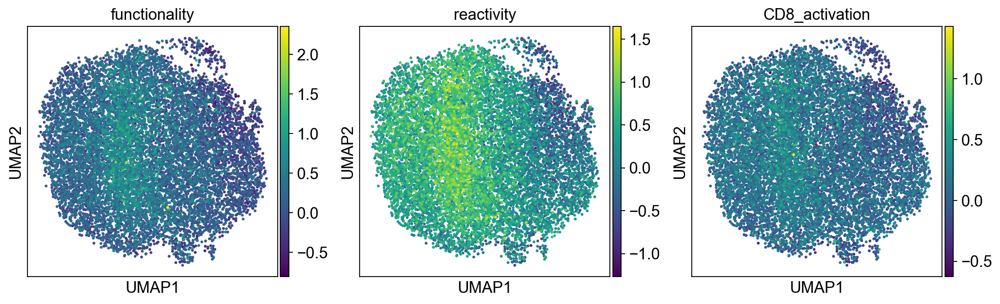

In [94]:
sc.pl.umap(adata_II, color=['functionality','reactivity','CD8_activation'], s=25, save='_scores_experiment_II.svg')